In [1]:
%load_ext autoreload
%autoreload 2
import SimilarityHelper
import sctop as top
import pandas as pd
import numpy as np
import scanpy as sc
import scipy
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns
from collections import Counter
import plotly.io as pio
import anndata as ad
pio.renderers.default = 'notebook'

/restricted/projectnb/crem-trainees/Kotton_Lab/Eitan/.conda/envs/KottonLab/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# basis = SimilarityHelper.loadHumanBasis(includeRas=True)
noRasBasis = SimilarityHelper.loadHumanBasis(includeRas=False)

Loaded basis!


In [20]:
completeHumanBasis = SimilarityHelper.loadHumanBasis(filtering=False, includeRas=False)

Loaded basis!


In [3]:
kathiriya, kathiriya_df, kathiriya_metadata, kathiriyaData, kathiriyaAnnotations, kathiriya_kwargs, kathiriyaKept = SimilarityHelper.processDataset("Kathiriya", filteringAnnObject=True, simplifying=False, keepAll=False)

Processing dataset...
Created Ann Object!
Created scTOP processed data


In [18]:
# onlyD7 = annObject[annObject.obs["orig.ident"] == "D7"]

In [12]:
# kathiriya.obs["celltypes"].value_counts()
kathiriya.obs

,orig.ident,nCount_spliced,nFeature_spliced,nCount_unspliced,nFeature_unspliced,nCount_ambiguous,nFeature_ambiguous,stim,percent.mt,integrated_snn_res.0.4,seurat_clusters,integrated_snn_res.0.2,integrated_snn_res.0.1,integrated_snn_res.0.3,integrated_snn_res.0.15,integrated_snn_res.0.25,celltypes
AAACCTGAGCACCGTC_d0_2,SeuratProject,4784.0,1585,2662.0,1170,665.0,294,a_d0,3.323579,1,2,2,2,2,2,1,5
AAACCTGCACATGGGA_d0_2,SeuratProject,4495.0,1381,2171.0,1116,722.0,282,a_d0,1.490545,1,2,2,2,2,2,1,5
AAACCTGTCATCATTC_d0_2,SeuratProject,3330.0,1148,1623.0,925,442.0,211,a_d0,5.195195,1,2,2,2,2,2,1,5
AAACCTGTCCAAGCCG_d0_2,SeuratProject,6032.0,1762,2702.0,1321,872.0,369,a_d0,2.635942,10,8,2,2,8,2,1,4
AAACGGGAGCTGCCCA_d0_2,SeuratProject,4040.0,1192,2284.0,1177,655.0,248,a_d0,4.356436,1,2,2,2,2,2,1,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTTCCTAAG_d21,D21,5232.0,1668,1336.0,758,407.0,264,d_d21,14.755352,0,0,0,1,0,1,0,1
TTTGTTGGTTCTTAGG_d21,D21,11386.0,2653,2070.0,1187,822.0,423,d_d21,8.071316,0,0,0,1,0,1,0,1
TTTGTTGTCCATCTAT_d21,D21,1368.0,703,140.0,122,115.0,91,d_d21,1.754386,9,9,4,3,9,4,7,3
TTTGTTGTCGAACCAT_d21,D21,7383.0,2034,1301.0,796,525.0,329,d_d21,21.034810,2,1,1,0,1,0,2,2


In [10]:
kathiriya.obs["stim"].value_counts()

stim
d_d21    10561
c_d14     3467
b_d7      3333
a_d0      2085
Name: count, dtype: int64

In [ ]:
# df = pd.DataFrame(onlyD7.X.toarray(), index = onlyD7.obs.index , columns = onlyD7.var.index).T
# metadata = onlyD7.obs
# cell_type_column = "celltypes"
# clusters = metadata[cell_type_column].values
# toKeep = [0, 1, 2, 3, 4, 5, 6]
# processedData = top.process(df)
# print("Created scTOP processed data")
# annotations = SimilarityHelper.setSourceAnnotations(clusters, toKeep, keepAll=True, simplifying=False)
# kwargs = SimilarityHelper.setArguments(annotations[annotations!='Other'])

In [6]:
projections_kathiriya = top.score(noRasBasis, kathiriyaData)
# projections_kathiriya_complete = top.score(completeHumanBasis, kathiriyaData)
print("Scored!")
# 0- Ciliated
# 1- Club or Goblet
# 2- Basal
# 3- ABI2
# 4- ABI1
# 5- AT2

Scored!


In [5]:
# projections_kathiriya_complete

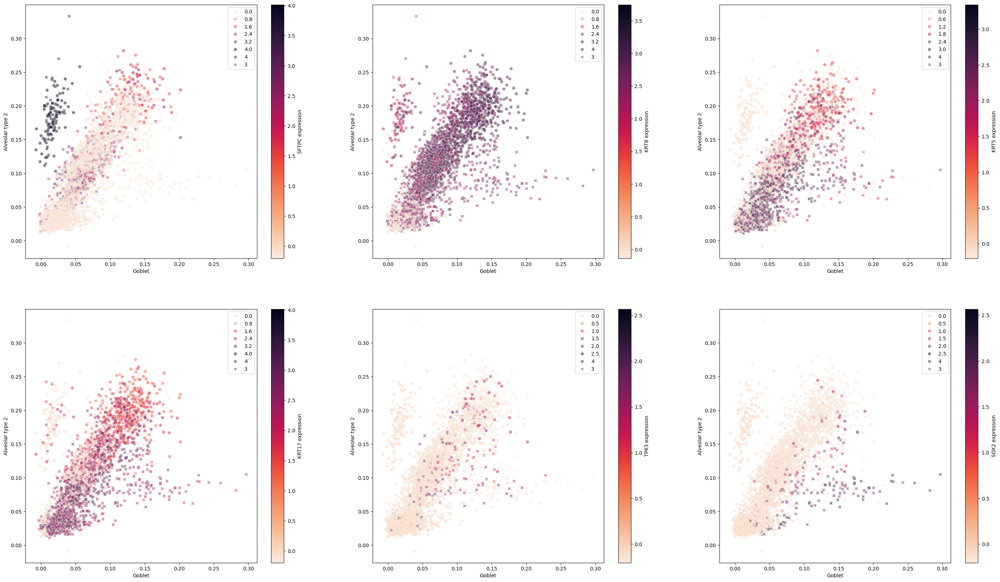

In [14]:
fig, ax = plt.subplots(2, 3, figsize=(35,20))
toKeep = [3, 4]
# marker_genes = ['Pdpn', 'Aqp5', 'Ager', 'Hopx', 'Vegfa'] # AT1
# marker_genes = ['Ctsh', 'Slc34a2', 'Cd74', 'Lyz2', 'Sftpc', 'Abca3'] #AT2
# marker_genes = ['Krt8', 'Sfn', 'Lgals3', 'Cldn4', 'Cdkn1a', 'Sprr1a'] # transition
# marker_genes = ['FOXA2', 'GATA4', 'KRT8', 'TP63', 'HES1', 'SOX2'] # transition
marker_genes = ['SFTPC', 'KRT8', 'KRT5', 'KRT17', 'TP63', 'SOX2'] # transition
clusters = kathiriya_metadata["celltypes"].values
annotations = SimilarityHelper.setSourceAnnotations(clusters, toKeep, keepAll=False, simplifying=False)
kwargs = SimilarityHelper.setArguments(annotations[annotations!='Other'])
axs = ax.flatten()
for i, gene in enumerate(marker_genes):
    current_ax = axs[i]
    SimilarityHelper.plot_two(projections_kathiriya.loc[:,annotations!='Other'], 
             'Goblet', 'Alveolar type 2',
             gene = gene, gene_expressions = kathiriyaData.loc[:,annotations!='Other'], ax=current_ax, **kwargs)
    current_ax.legend()

# plt.legend(handles=source_legend[:])
plt.show()

In [9]:
4-3

1

In [7]:
annotationType = kathiriyaAnnotations
annotationMap = {0: "Ciliated", 1: "Club", 2: "Basal", 3: "ABI2", 4: "ABI1", 5: "AT2"}
newAnnotations = []
for annotation in annotationType:
    if annotation in annotationMap and annotation != 0:
        newAnnotations.append(annotationMap[annotation])
    else:
        newAnnotations.append("Other")
newAnnotations = np.array(newAnnotations)

In [24]:
cell_type_column="celltypes"
truePredictedMap = SimilarityHelper.getTopPredictedMap(projections_kathiriya_complete, kathiriya_metadata, cell_type_column=cell_type_column)
# valList = Counter(truePredictedMap[4])
# valList
truePredictedMap.keys()

dict_keys([np.int32(5), np.int32(4), np.int32(3), np.int32(2), np.int32(1), np.int32(0)])

In [52]:
valList = Counter(truePredictedMap[1])
valList

Counter({'Basal': 2153, 'Goblet': 2109, 'Respiratory airway secretory': 267})

In [27]:
labels = []
values = []
cluster = 3
clusterName = cluster
valList = Counter(truePredictedMap[cluster])
for name in valList:
    val = valList[name]
    if val > 5:
        labels.append(name)
        values.append(valList[name])
valListFrame = pd.DataFrame([{'Label': k, 'Top Matches to ' + str(clusterName): v} for k, v in valList.items()])
valListFrame = valListFrame.set_index("Label")
print(valListFrame)
labels = []
values = []
cluster = 4
clusterName = cluster
valList = Counter(truePredictedMap[cluster])
for name in valList:
    val = valList[name]
    if val > 5:
        labels.append(name)
        values.append(valList[name])
valListFrame = pd.DataFrame([{'Label': k, 'Top Matches to ' + str(clusterName): v} for k, v in valList.items()])
valListFrame = valListFrame.set_index("Label")
print(valListFrame)

                               Top Matches to 3
Label                                          
Alveolar type 2                             779
Inflammatory monocyte                       137
Secondary crest myofibroblast               705
Suprabasal                                 1163
CD8+ T                                      137
Capillary 2                                   1
Myoepithelial                                12
Mast/Basophil                                 3
Respiratory airway secretory                 25
Basal                                         5
Alveolar macrophage                           7
Systemic venous endothelial                   2
Airway smooth muscle                          3
Secretory                                    41
Lymphatic endothelial                         2
Goblet                                        2
Ciliated                                      3
Plasma                                        1
                               Top Match

In [7]:
kathiriya_metadata_copy = kathiriya_metadata
kathiriya_metadata_copy = kathiriya_metadata_copy.replace({"celltypes":annotationMap})
kathiriya_metadata_copy
# kathiriya_metadata['celltypes'].replace(annotationMap)

,orig.ident,nCount_spliced,nFeature_spliced,nCount_unspliced,nFeature_unspliced,nCount_ambiguous,nFeature_ambiguous,stim,percent.mt,integrated_snn_res.0.4,seurat_clusters,integrated_snn_res.0.2,integrated_snn_res.0.1,integrated_snn_res.0.3,integrated_snn_res.0.15,integrated_snn_res.0.25,celltypes
AAACCTGAGCACCGTC_d0_2,SeuratProject,4784.0,1585,2662.0,1170,665.0,294,a_d0,3.323579,1,2,2,2,2,2,1,AT2
AAACCTGCACATGGGA_d0_2,SeuratProject,4495.0,1381,2171.0,1116,722.0,282,a_d0,1.490545,1,2,2,2,2,2,1,AT2
AAACCTGTCATCATTC_d0_2,SeuratProject,3330.0,1148,1623.0,925,442.0,211,a_d0,5.195195,1,2,2,2,2,2,1,AT2
AAACCTGTCCAAGCCG_d0_2,SeuratProject,6032.0,1762,2702.0,1321,872.0,369,a_d0,2.635942,10,8,2,2,8,2,1,ABI1
AAACGGGAGCTGCCCA_d0_2,SeuratProject,4040.0,1192,2284.0,1177,655.0,248,a_d0,4.356436,1,2,2,2,2,2,1,AT2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTTCCTAAG_d21,D21,5232.0,1668,1336.0,758,407.0,264,d_d21,14.755352,0,0,0,1,0,1,0,Goblet
TTTGTTGGTTCTTAGG_d21,D21,11386.0,2653,2070.0,1187,822.0,423,d_d21,8.071316,0,0,0,1,0,1,0,Goblet
TTTGTTGTCCATCTAT_d21,D21,1368.0,703,140.0,122,115.0,91,d_d21,1.754386,9,9,4,3,9,4,7,ABI2
TTTGTTGTCGAACCAT_d21,D21,7383.0,2034,1301.0,796,525.0,329,d_d21,21.034810,2,1,1,0,1,0,2,Basal


In [19]:
suffixes = []
for name in kathiriya.obs.index:
    suffixes.append(name.split("_")[1])
suffixes = np.array(suffixes)

def suffixSort(suffix):
    return int(suffix.split('d')[1])
suffixesSorted = sorted([str(suffix) for suffix in set(suffixes)], key=suffixSort)

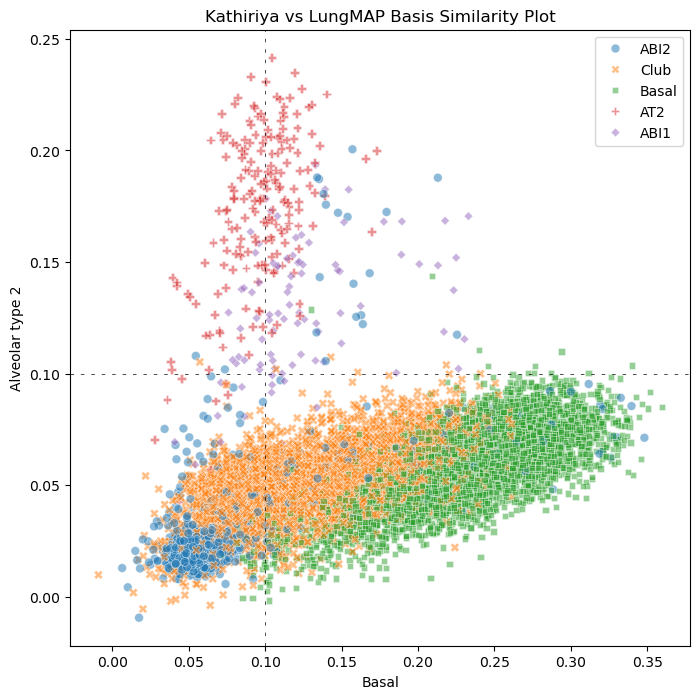

In [11]:
fig, ax = plt.subplots(1, 1, figsize=(8,8))
suffix = "d21"
revisedProjections = projections_kathiriya.loc[:, np.logical_and(newAnnotations != 'Other', suffixes == suffix)]
revisedAnnotations = newAnnotations[np.logical_and(newAnnotations != 'Other', suffixes == suffix)]
axis1 = 'Basal'
axis2 = 'Alveolar type 2'
palette = SimilarityHelper.plot_two(revisedProjections,
         axis1, axis2,
         ax=ax, hue=revisedAnnotations,
         s=40, style=revisedAnnotations)
plt.legend(bbox_to_anchor=(1,1))

plt.title("Kathiriya vs LungMAP Basis Similarity Plot")
plt.savefig('../Kathiriya/results/d21 Basal vs AT2 Kathiriya vs Human Basis')
plt.show()

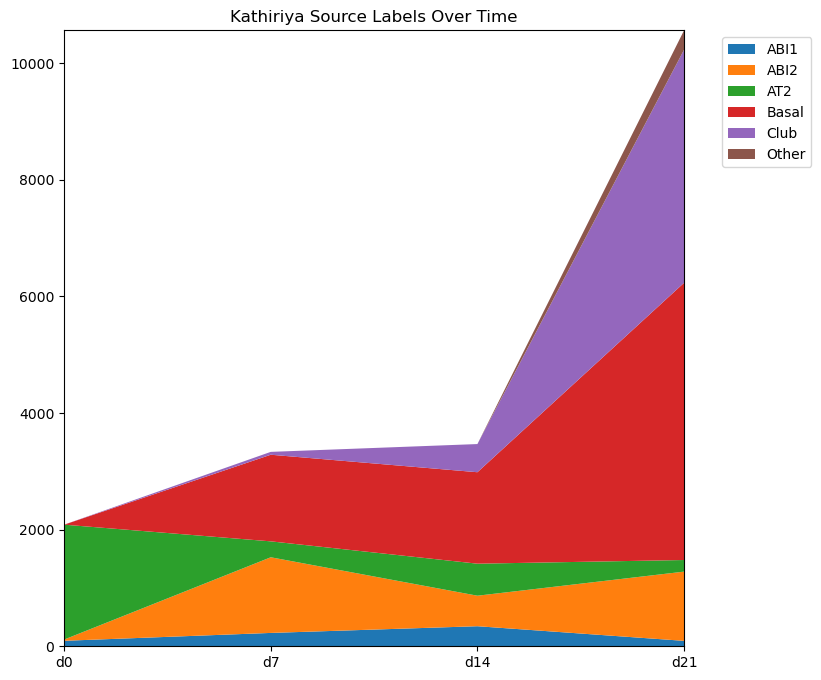

In [87]:
fig, ax = SimilarityHelper.plot_proportions(newAnnotations, suffixes, suffixSort, rawCounts=True)
plt.title("Kathiriya Source Labels Over Time")
plt.savefig('../Kathiriya/results/Kathiriya Source Labels Time Raw Counts Proportions Plot')
plt.show()

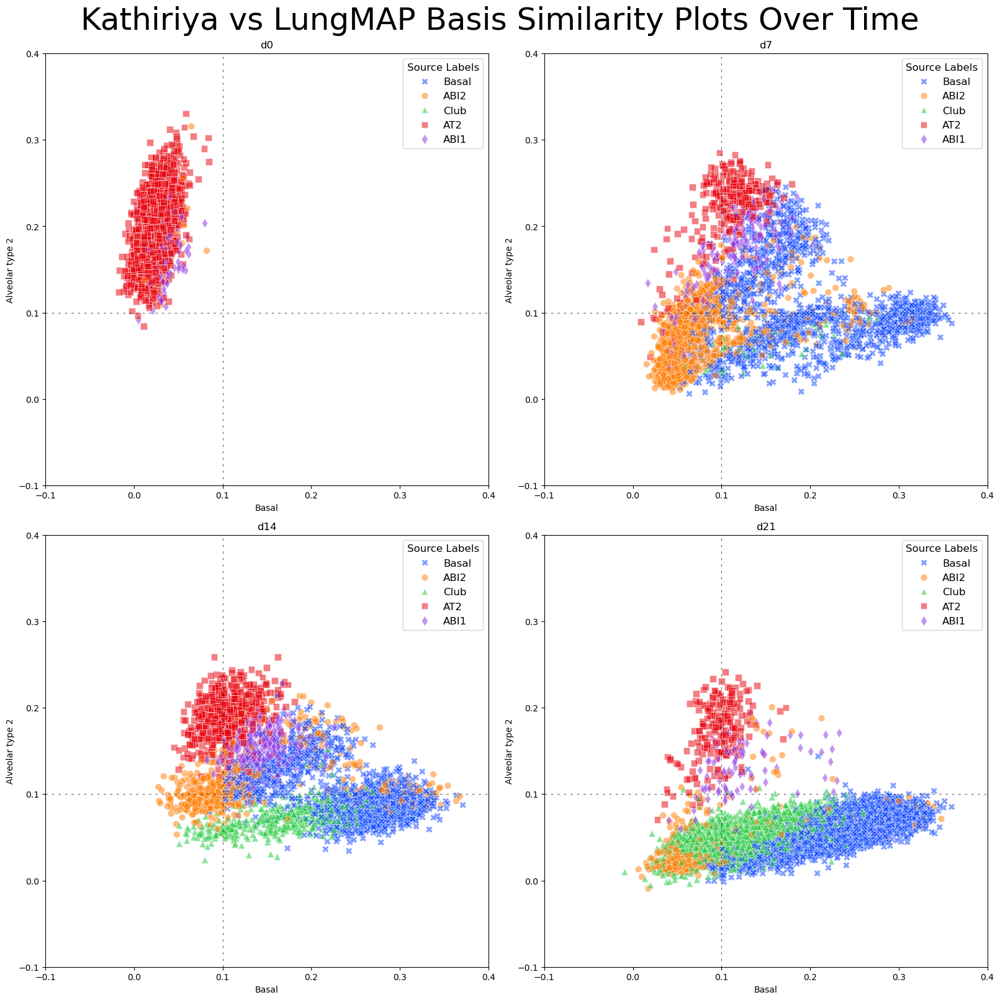

In [29]:
fig, axes = SimilarityHelper.plot_two_multiple(
    projections_kathiriya, 
    'Basal', 'Alveolar type 2', 
    newAnnotations,
    suffixes, suffixesSorted,
    legendFontSize=12
)
    
fig.suptitle("Kathiriya vs LungMAP Basis Similarity Plots Over Time", fontsize=36)
plt.savefig('../Kathiriya/results/All Days Kathiriya vs LungMAP Basal vs AT2.png')
plt.show()

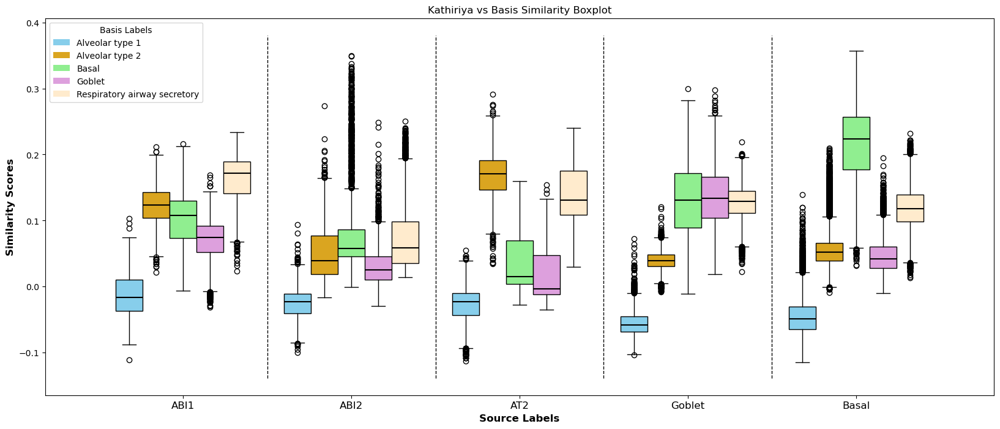

In [58]:
kathiriyaKept = ["ABI1", "ABI2", "AT2", "Goblet", "Basal"]
basisKept = ['Alveolar type 1', 'Alveolar type 2', 'Basal', "Goblet", "Respiratory airway secretory"]
cell_type_column = "celltypes"
kathiriyaSimilarityMap = SimilarityHelper.getMatchingProjections(projections_kathiriya, kathiriya_metadata_copy, cell_type_column, basisKept, kathiriyaKept)
fig, ax = plt.subplots(figsize=(20, 8))
plt.title("Kathiriya vs Basis Similarity Boxplot")
SimilarityHelper.similarityBoxplot(ax, kathiriyaKept, basisKept, kathiriyaSimilarityMap)
plt.savefig('Kathiriya vs Basis Similarity Boxplot.png')
plt.show()

In [62]:
revisedProjections = projections_kathiriya.loc[:, newAnnotations!='Other']
xLabel = 'Respiratory airway secretory'
yLabel = 'Alveolar type 2'
zLabel = 'Basal'
legendTitle = "Kathiriya Annotations"
figureTitle = "Kathiriya vs Human Basis Similarity Plot"
names = newAnnotations[newAnnotations!='Other']
SimilarityHelper.plot_three(revisedProjections, xLabel, yLabel, zLabel, names, figureTitle=figureTitle, legendTitle=legendTitle)

In [63]:
kathiriyaEmbedding = SimilarityHelper.getEmbedding(kathiriyaData)


/restricted/projectnb/crem-trainees/Kotton_Lab/Eitan/.conda/envs/KottonLab/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



19446


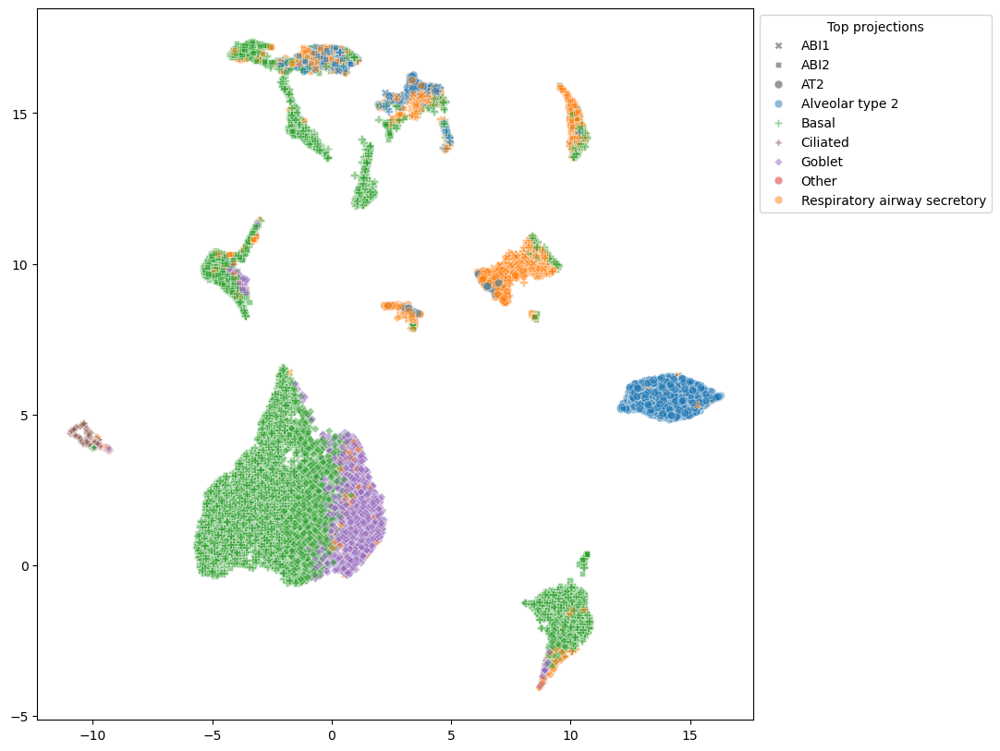

In [66]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
kwargs = SimilarityHelper.setArguments(newAnnotations)
SimilarityHelper.plot_top(projections_kathiriya.loc[:,newAnnotations!='Other'], kathiriyaEmbedding, **kwargs)

handles, labels = ax.get_legend_handles_labels()
# sort the legend labels (this snippet of code was taken from Stack Overflow user "kevin")
# source: stackoverflow.com/questions/22263807/how-is-order-of-items-in-matplotlib-legend-determined
labels, handles = zip(*sorted(zip(labels, handles), key=lambda t: t[0]))
ax.legend(handles, labels, bbox_to_anchor=(1,1), title='Top projections')
plt.savefig('Kathiriya Cell Labels for PCA Projection Scores onto Basis.png')
plt.show()

In [4]:
kostasClusterMap = {}
Kostas5 = sc.read_10x_h5("../KostasHuman/CG5.h5")
Kostas5.var_names_make_unique()
kostasClusterMap[5] = (Kostas5, "Cluster 5")
Kostas6 = sc.read_10x_h5("../KostasHuman/CG6.h5")
Kostas6.var_names_make_unique()
kostasClusterMap[6] = (Kostas6, "Cluster 6")
Kostas7 = sc.read_10x_h5("../KostasHuman/CG7.h5")
Kostas7.var_names_make_unique()
kostasClusterMap[7] = (Kostas7, "Cluster 7")
Kostas8 = sc.read_10x_h5("../KostasHuman/CG8.h5")
Kostas8.var_names_make_unique()
kostasClusterMap[8] = (Kostas8, "Cluster 8")
Kostas12 = sc.read_10x_h5("../KostasHuman/CG12.h5")
Kostas12.var_names_make_unique()
kostasClusterMap[12] = (Kostas12, "Cluster 12")
Kostas13 = sc.read_10x_h5("../KostasHuman/CG13.h5")
Kostas13.var_names_make_unique()
kostasClusterMap[13] = (Kostas13, "Cluster 13")
Kostas14 = sc.read_10x_h5("../KostasHuman/CG14.h5")
Kostas14.var_names_make_unique()
kostasClusterMap[14] = (Kostas14, "Cluster 14 Transitional")

/restricted/projectnb/crem-trainees/Kotton_Lab/Eitan/.conda/envs/KottonLab/lib/python3.10/site-packages/anndata/_core/anndata.py:1758: UserWarning:

Variable names are not unique. To make them unique, call `.var_names_make_unique`.

/restricted/projectnb/crem-trainees/Kotton_Lab/Eitan/.conda/envs/KottonLab/lib/python3.10/site-packages/anndata/_core/anndata.py:1758: UserWarning:

Variable names are not unique. To make them unique, call `.var_names_make_unique`.

/restricted/projectnb/crem-trainees/Kotton_Lab/Eitan/.conda/envs/KottonLab/lib/python3.10/site-packages/anndata/_core/anndata.py:1758: UserWarning:

Variable names are not unique. To make them unique, call `.var_names_make_unique`.

/restricted/projectnb/crem-trainees/Kotton_Lab/Eitan/.conda/envs/KottonLab/lib/python3.10/site-packages/anndata/_core/anndata.py:1758: UserWarning:

Variable names are not unique. To make them unique, call `.var_names_make_unique`.

/restricted/projectnb/crem-trainees/Kotton_Lab/Eitan/.conda/envs/Kot

In [17]:
kostasClusterMapCopy = {}
clusterList = []
clusterNames = []

for clusterNum in kostasClusterMap:
    cluster, celltype = kostasClusterMap[clusterNum]
    cluster.obs["celltype"] = celltype
    kostasClusterMapCopy[clusterNum] = cluster
    clusterList.append(cluster)
    clusterNames.append(celltype)
    
# Kostas14.obs["celltype"] = "Cluster 14 Transitional"
# Kostas7.obs["celltype"] = "Cluster 7 AT2"
# Kostas8.obs["celltype"] = "Cluster 8 AT2"

In [132]:
Kostas14_df = pd.DataFrame(Kostas14.X.toarray(), index = Kostas14.obs.index , columns = Kostas14.var.index).T

In [119]:
# Kostas7.obs.index = [f"{name}_2" for name in Kostas7.obs.index]

,celltype
AAACCCATCACCTCTG-1_7,Cluster 7 AT2
AAACGCTCAACATCGT-1_7,Cluster 7 AT2
AAAGAACCAGGACGAT-1_7,Cluster 7 AT2
AAAGGATCAAACGTGG-1_7,Cluster 7 AT2
AAAGGATCATATTCGG-1_7,Cluster 7 AT2
...,...
TTTGGAGTCTACTATC-1_7,Cluster 7 AT2
TTTGGTTAGCTCTTCC-1_7,Cluster 7 AT2
TTTGGTTAGGAATCGC-1_7,Cluster 7 AT2
TTTGTTGTCACCATCC-1_7,Cluster 7 AT2


In [6]:
combinedKostas = ad.concat(clusterList, join="inner", merge="same")
combinedKostas.obs_names_make_unique()

/restricted/projectnb/crem-trainees/Kotton_Lab/Eitan/.conda/envs/KottonLab/lib/python3.10/site-packages/anndata/_core/anndata.py:1756: UserWarning:

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.



In [7]:
Kostas_df = pd.DataFrame(combinedKostas.X.toarray(), index = combinedKostas.obs.index , columns = combinedKostas.var.index).T
kostasData = top.process(Kostas_df)
print("Scored!")


In [14]:
projections_kostas_no_ras = top.score(noRasBasis, kostasData)
# projections_kostas_kathiriya = top.score(basis, kathiriyaData)
# projections_kostas = top.score(basis, kostasData)

In [15]:
kostasMetadata = combinedKostas.obs
truePredictedMapKostas = SimilarityHelper.getTopPredictedMap(projections_kostas_no_ras, kostasMetadata, cell_type_column="celltype")
# Counter(truePredictedMapHabermann["KRT5-/KRT17+"])
Counter(truePredictedMapKostas["Cluster 14"])


Counter({'Basal': 1253, 'Alveolar type 2': 954, 'Alveolar type 1': 25})

In [12]:
Counter(truePredictedMapKostas["Cluster 14"])

Counter({'Respiratory airway secretory': 1674,
         'Basal': 431,
         'Alveolar type 2': 107,
         'Alveolar type 1': 20})

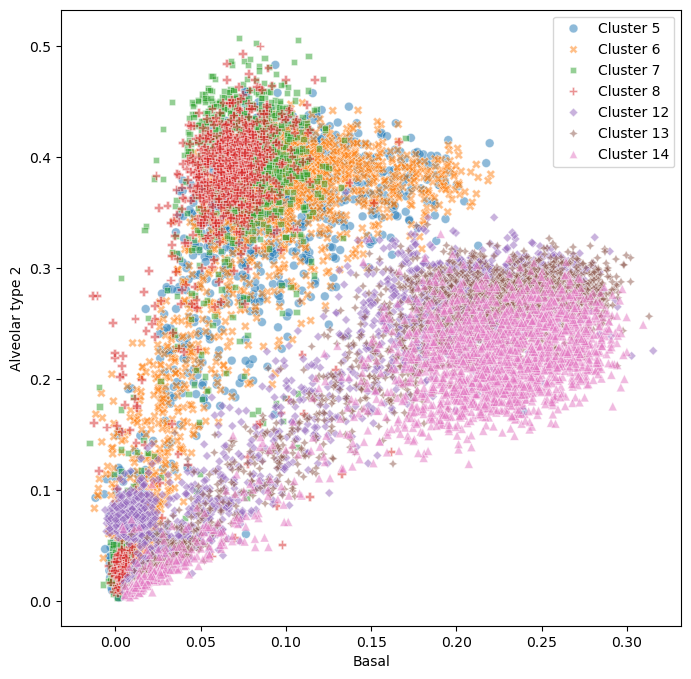

In [20]:
fig, ax = plt.subplots(1, 1, figsize=(8,8))
toKeep = clusterNames
clusters = kostasMetadata["celltype"].values
annotations = SimilarityHelper.setSourceAnnotations(clusters, toKeep, keepAll=True, simplifying=False)
kwargs = SimilarityHelper.setArguments(annotations[annotations!='Other'])
SimilarityHelper.plot_two(projections_kostas_no_ras.loc[:, annotations!='Other'],
         'Basal', 'Alveolar type 2',
         ax=ax, hue=annotations[annotations!='Other'],
         s=40, style=annotations[annotations!='Other'])
plt.legend(bbox_to_anchor=(1,1))
plt.savefig('Kostas Human vs Basis Basal vs AT2.png')
plt.show()

In [16]:
basis.columns

Index(['Alveolar type 2', 'Ciliated', 'Basal', 'Alveolar type 1',
       'Respiratory airway secretory', 'Goblet'],
      dtype='object')

In [52]:
habermann, habermann_df, habermann_metadata, habermannData, habermannAnnotations, habermann_kwargs, habermannKept = SimilarityHelper.processDataset("Habermann", simplifying=False, keepAll=False, filteringAnnObject=True)

Processing dataset...
Created Ann Object!
Created scTOP processed data


In [53]:
habermann.obs

,orig.ident,nCount_RNA,nFeature_RNA,Diagnosis,Sample_Name,Sample_Source,Status,percent.mt,nCount_SCT,nFeature_SCT,seurat_clusters,celltype
index,,,,,,,,,,,,
F00202_ACTATCTAGATGTTAG,F00202,5605.0,2276,NSIP,VUILD48,Vanderbilt,ILD,10.383586,6051.0,2276,30,Proliferating Epithelial Cells
F00207_GCTTCCAGTTTGTTGG,F00207,25941.0,5642,cHP,VUILD54,Vanderbilt,ILD,8.935662,7501.0,3161,30,Proliferating Epithelial Cells
F00208_GTTAAGCAGGTAGCTG,F00208,3665.0,1616,cHP,VUILD54,Vanderbilt,ILD,18.799454,5661.0,1628,30,Proliferating Epithelial Cells
F00409_ACGATACGTAAGTAGT,F00409,4676.0,2661,Control,VUHD69,Vanderbilt,Control,1.860565,5375.0,2660,30,Proliferating Epithelial Cells
F00409_CCGTTCACACCCAGTG,F00409,4453.0,2031,Control,VUHD69,Vanderbilt,Control,9.431844,5545.0,2031,30,Proliferating Epithelial Cells
...,...,...,...,...,...,...,...,...,...,...,...,...
ILD62-2_TTCTACACAACACCCG,ILD62-2,4017.0,1978,NSIP,VUILD62,Vanderbilt,ILD,1.991536,5467.0,1982,19,AT1
ILD62-2_TTGACTTAGTATCTCG,ILD62-2,4045.0,2012,NSIP,VUILD62,Vanderbilt,ILD,5.018541,5493.0,2016,19,AT1
ILD62-2_TTGGCAAAGCGTAATA,ILD62-2,4893.0,2065,NSIP,VUILD62,Vanderbilt,ILD,3.617413,5788.0,2065,19,AT1


In [30]:
projections_habermann = top.score(noRasBasis, habermannData)
projections_habermann

index,F00202_ACTATCTAGATGTTAG,F00207_GCTTCCAGTTTGTTGG,F00208_GTTAAGCAGGTAGCTG,F00409_ACGATACGTAAGTAGT,F00409_CCGTTCACACCCAGTG,F01157_AAACGGGTCCTTTCGG,F01157_AAATGCCGTTCTGTTT,F01157_AACTCTTAGCAGCCTC,F01157_ACCTTTACAACACGCC,F01157_ACGAGCCTCACATGCA,...,ILD62-2_TGACTTTCATGGTCAT,ILD62-2_TGAGAGGCATCGATGT,ILD62-2_TGATTTCGTCCGTCAG,ILD62-2_TGCGCAGCAAGGTTTC,ILD62-2_TGTGGTACAGCGTAAG,ILD62-2_TTCTACACAACACCCG,ILD62-2_TTGACTTAGTATCTCG,ILD62-2_TTGGCAAAGCGTAATA,ILD62-2_TTGGCAATCGTAGATC,ILD62-2_TTTGCGCTCCTCCTAG
Alveolar type 2,0.063319,0.097278,0.061517,0.029549,0.072324,0.406480,0.334275,0.414754,0.270888,0.392336,...,0.040677,0.020024,0.048183,0.087696,0.016277,0.024550,0.056117,0.064082,0.077990,0.091271
Ciliated,-0.032439,-0.027422,0.011617,-0.019395,0.073641,-0.059288,-0.046099,-0.079537,-0.060330,-0.056784,...,-0.044425,-0.031698,-0.057634,-0.036519,-0.045697,-0.053892,-0.038919,-0.060676,-0.051240,-0.054652
Basal,0.162906,0.347149,0.115208,0.098956,0.021851,0.076337,0.109463,0.065629,0.016851,0.063317,...,0.023623,0.017978,0.067431,0.050040,0.042976,0.039796,0.038647,0.064615,0.031523,0.062559
Alveolar type 1,0.004398,-0.030474,-0.019050,0.173734,0.088169,-0.035052,-0.052970,0.058833,0.080455,0.018501,...,0.174556,0.172789,0.193210,0.104817,0.148812,0.249090,0.207397,0.172879,0.196819,0.168154
Secretory,0.137167,0.181731,0.082767,0.007076,0.021532,0.070282,0.111520,0.013858,0.052008,0.033386,...,0.026175,0.029401,0.074949,0.059454,0.053776,0.050176,0.050268,0.080499,0.076217,0.078977
Goblet,-0.034958,0.009464,0.012547,-0.001867,0.012157,0.031496,-0.012919,0.057581,0.025457,0.020205,...,0.010353,0.007313,-0.006335,-0.012632,-0.008520,-0.007895,-0.000452,0.004649,-0.006151,-0.013065


In [93]:
truePredictedMapHabermann = SimilarityHelper.getTopPredictedMap(projections_habermann, habermann_metadata, cell_type_column="celltype")
# Counter(truePredictedMapHabermann["KRT5-/KRT17+"])
Counter(truePredictedMapHabermann["AT2"])

Counter({'Alveolar type 2': 9309, 'Ciliated': 1, 'Alveolar type 1': 1})

In [7]:
habermann_metadata["celltype"].value_counts()

celltype
Ciliated                          14671
AT2                                9311
SCGB3A2+                           3220
MUC5B+                             2433
Basal                              2058
SCGB3A2+ SCGB1A1+                  1410
Differentiating Ciliated           1362
Transitional AT2                   1160
AT1                                 771
KRT5-/KRT17+                        485
Proliferating Epithelial Cells      341
MUC5AC+ High                        103
Name: count, dtype: int64

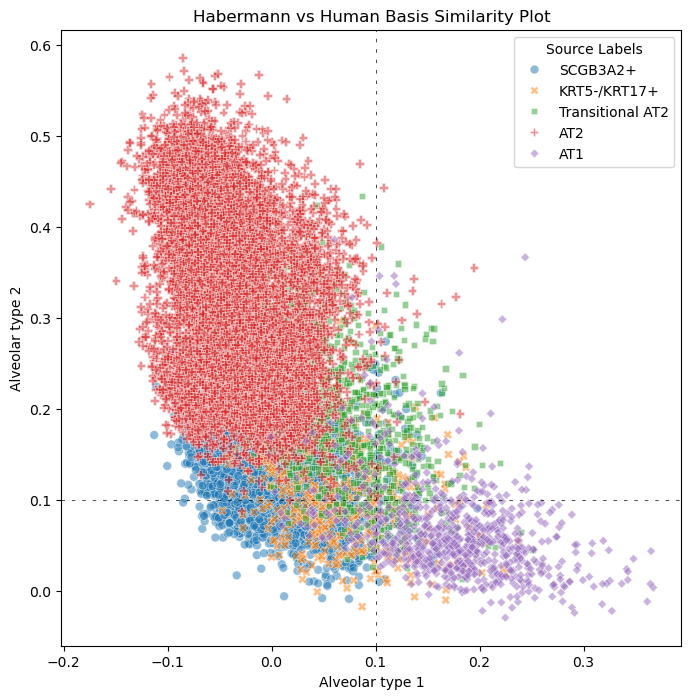

In [31]:
fig, ax = plt.subplots(1, 1, figsize=(8,8))
toKeep = ["AT1", "AT2", "KRT5-/KRT17+", "Transitional AT2", "SCGB3A2+", "Basal"]
clusters = habermann_metadata["celltype"].values
annotations = SimilarityHelper.setSourceAnnotations(clusters, toKeep, keepAll=False, simplifying=False)
kwargs = SimilarityHelper.setArguments(annotations[annotations!='Other'])

# annotations = habermannAnnotations
revisedProjections = projections_habermann.loc[:, annotations!='Other']
revisedAnnotations = annotations[annotations!='Other']
axis1 = 'Alveolar type 1'
axis2 = 'Alveolar type 2'

palette = SimilarityHelper.plot_two(revisedProjections,
         axis1, axis2,
         ax=ax, hue=revisedAnnotations,
         s=40, style=revisedAnnotations)
plt.legend(bbox_to_anchor=(1,1), title=("Source Labels"))

plt.title("Habermann vs Human Basis Similarity Plot")
plt.savefig('AT1 vs AT2 Habermann vs Human Basis')
plt.show()

In [44]:
clusters = habermann_metadata["celltype"].values
toKeep = ["AT1", "AT2", "KRT5-/KRT17+", "Transitional AT2", "SCGB3A2+", "Basal"]
annotations = SimilarityHelper.setSourceAnnotations(clusters, toKeep, keepAll=False)

revisedProjections = projections_habermann.loc[:, annotations!='Other']
xLabel = 'Alveolar type 1'
yLabel = 'Alveolar type 2'
zLabel = 'Basal'
legendTitle = "Habermann Annotations"
figureTitle = "Habermann 3D Similarity Plot"
names = annotations[annotations!='Other']
SimilarityHelper.plot_three(revisedProjections, xLabel, yLabel, zLabel, names, figureTitle=figureTitle, legendTitle=legendTitle)

In [25]:
kathiriya_metadata_copy = kathiriya_metadata
kathiriya_metadata_copy = kathiriya_metadata_copy.replace({"celltypes":annotationMap})
kathiriya_metadata_copy
# kathiriya_metadata['celltypes'].replace(annotationMap)

,orig.ident,nCount_spliced,nFeature_spliced,nCount_unspliced,nFeature_unspliced,nCount_ambiguous,nFeature_ambiguous,stim,percent.mt,integrated_snn_res.0.4,seurat_clusters,integrated_snn_res.0.2,integrated_snn_res.0.1,integrated_snn_res.0.3,integrated_snn_res.0.15,integrated_snn_res.0.25,celltypes
AAACCTGAGCACCGTC_d0_2,SeuratProject,4784.0,1585,2662.0,1170,665.0,294,a_d0,3.323579,1,2,2,2,2,2,1,AT2
AAACCTGCACATGGGA_d0_2,SeuratProject,4495.0,1381,2171.0,1116,722.0,282,a_d0,1.490545,1,2,2,2,2,2,1,AT2
AAACCTGTCATCATTC_d0_2,SeuratProject,3330.0,1148,1623.0,925,442.0,211,a_d0,5.195195,1,2,2,2,2,2,1,AT2
AAACCTGTCCAAGCCG_d0_2,SeuratProject,6032.0,1762,2702.0,1321,872.0,369,a_d0,2.635942,10,8,2,2,8,2,1,ABI1
AAACGGGAGCTGCCCA_d0_2,SeuratProject,4040.0,1192,2284.0,1177,655.0,248,a_d0,4.356436,1,2,2,2,2,2,1,AT2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTTCCTAAG_d21,D21,5232.0,1668,1336.0,758,407.0,264,d_d21,14.755352,0,0,0,1,0,1,0,Club/Goblet
TTTGTTGGTTCTTAGG_d21,D21,11386.0,2653,2070.0,1187,822.0,423,d_d21,8.071316,0,0,0,1,0,1,0,Club/Goblet
TTTGTTGTCCATCTAT_d21,D21,1368.0,703,140.0,122,115.0,91,d_d21,1.754386,9,9,4,3,9,4,7,ABI2
TTTGTTGTCGAACCAT_d21,D21,7383.0,2034,1301.0,796,525.0,329,d_d21,21.034810,2,1,1,0,1,0,2,Basal


In [67]:
# kathiriya_metadata_copy = kathiriya_metadata
# kathiriya_metadata_copy = kathiriya_metadata_copy.replace({"celltypes":annotationMap})
# basis2 = SimilarityHelper.setBasis(kathiriya_df, kathiriya_metadata_copy, cell_type_column="celltypes")
# basis2
kathiriyaBasis = SimilarityHelper.combineBases(basis, kathiriya_df, kathiriya_metadata_copy, ["ABI2"], cell_type_column='celltypes')
kathiriyaBasis

100%|██████████| 6/6 [00:00<00:00,  7.56it/s]


Basis set!


,Alveolar type 2,Ciliated,Basal,Alveolar type 1,Respiratory airway secretory,Goblet,ABI2
gene,,,,,,,
MIR1302-2HG,-0.796397,-0.955690,-0.873868,-0.788956,-0.767724,-0.887370,-0.533185
FAM138A,-0.796397,-0.955690,-0.873868,-0.788956,-0.767724,-0.887370,-0.533185
OR4F5,-0.796397,-0.955690,-0.873868,-0.788956,-0.767724,-0.887370,-0.533185
AL627309.1,0.052626,-0.090224,0.204802,0.002096,-0.767724,-0.135156,-0.533185
AL627309.3,-0.796397,-0.955690,-0.873868,-0.083015,-0.767724,-0.887370,-0.533185
...,...,...,...,...,...,...,...
AC141272.1,-0.796397,-0.955690,-0.873868,-0.788956,-0.767724,-0.887370,-0.533185
AC023491.2,-0.796397,-0.392208,-0.873868,-0.788956,-0.767724,-0.887370,-0.533185
AC007325.1,-0.796397,-0.296285,-0.873868,-0.788956,-0.767724,-0.887370,-0.533185


In [68]:
projections_habermann_kathiriya = top.score(kathiriyaBasis, habermannData)

In [192]:
habermann.obs["celltype"].value_counts()

celltype
Ciliated                          14671
AT2                                9311
SCGB3A2+                           3220
MUC5B+                             2433
Basal                              2058
SCGB3A2+ SCGB1A1+                  1410
Differentiating Ciliated           1362
Transitional AT2                   1160
AT1                                 771
KRT5-/KRT17+                        485
Proliferating Epithelial Cells      341
MUC5AC+ High                        103
Name: count, dtype: int64

In [69]:
clusters = habermann_metadata["celltype"].values
toKeep = ["AT1", "AT2", "KRT5-/KRT17+", "Proliferating Epithelial Cells", "Transitional AT2", "SCGB3A2+", "Basal"]
annotations = SimilarityHelper.setSourceAnnotations(clusters, toKeep, keepAll=False)

revisedProjections = projections_habermann_kathiriya.loc[:, annotations!='Other']
xLabel = 'Alveolar type 1'
yLabel = 'Alveolar type 2'
zLabel = 'ABI2'
legendTitle = "Habermann Annotations"
figureTitle = "Habermann vs Kathiriya Similarity Plot"
names = annotations[annotations!='Other']
SimilarityHelper.plot_three(revisedProjections, xLabel, yLabel, zLabel, names, figureTitle=figureTitle, legendTitle=legendTitle)

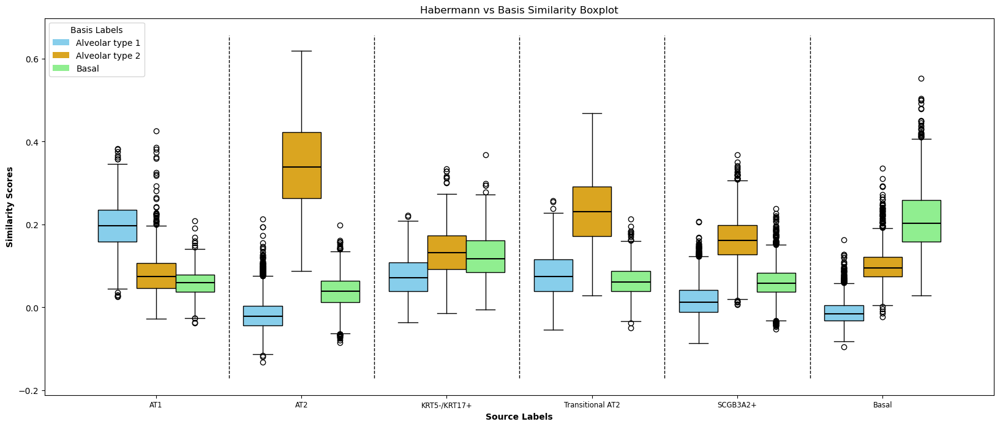

In [209]:
habermannKept = ["AT1", "AT2", "KRT5-/KRT17+", "Transitional AT2", "SCGB3A2+", "Basal"]
basisKept = ['Alveolar type 1', 'Alveolar type 2', 'Basal']
cell_type_column = "celltype"
habermannSimilarityMap = SimilarityHelper.getMatchingProjections(projections_habermann, habermann_metadata, cell_type_column, basisKept, habermannKept)
fig, ax = plt.subplots(figsize=(20, 8))
plt.title("Habermann vs Basis Similarity Boxplot")
SimilarityHelper.similarityBoxplot(ax, habermannKept, basisKept, habermannSimilarityMap)
plt.savefig('Habermann vs Basis Similarity Boxplot.png')
plt.show()

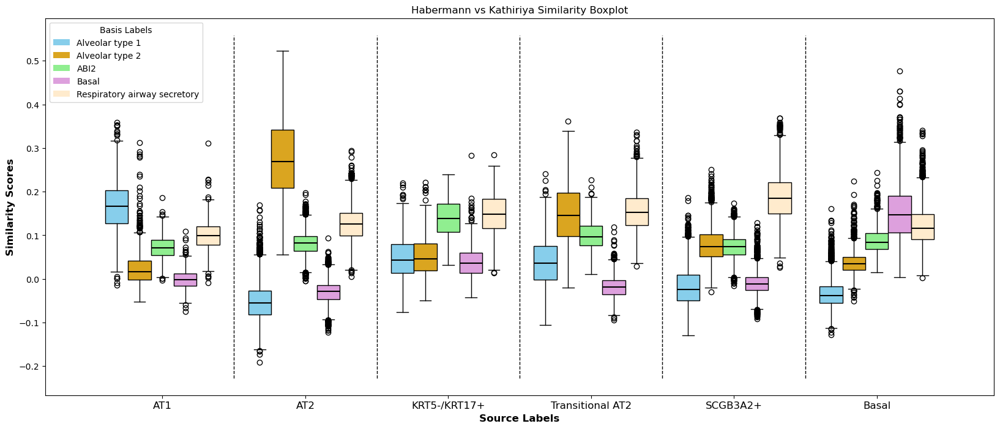

In [72]:
habermannKept = ["AT1", "AT2", "KRT5-/KRT17+", "Transitional AT2", "SCGB3A2+", "Basal"]
basisKept = ['Alveolar type 1', 'Alveolar type 2', 'ABI2', "Basal", "Respiratory airway secretory"]
cell_type_column = "celltype"
habermannSimilarityMap = SimilarityHelper.getMatchingProjections(projections_habermann_kathiriya, habermann_metadata, cell_type_column, basisKept, habermannKept)
fig, ax = plt.subplots(figsize=(20, 8))
plt.title("Habermann vs Kathiriya Similarity Boxplot")
SimilarityHelper.similarityBoxplot(ax, habermannKept, basisKept, habermannSimilarityMap)
# plt.savefig('Habermann vs Kathiriya Similarity Boxplot.png')
plt.show()

In [77]:
projections_kostas_kathiriya = top.score(kathiriyaBasis, kostasData)

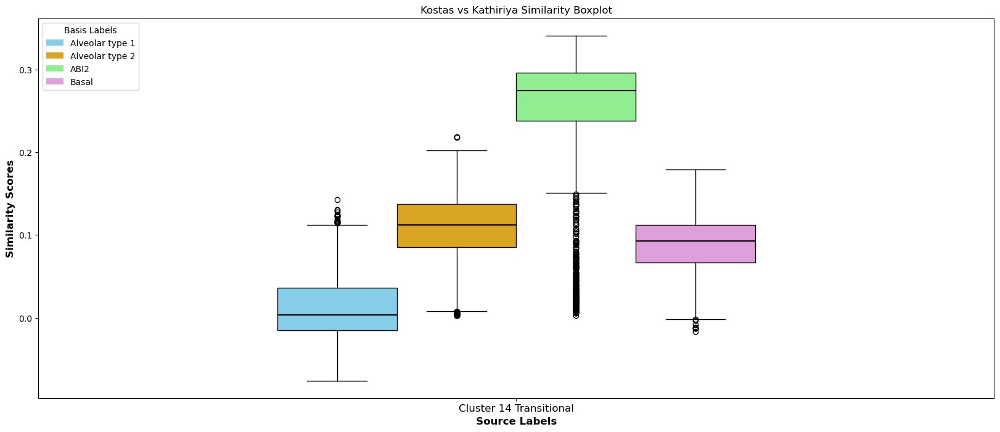

In [84]:
kostasKept = ["Cluster 14 Transitional"]
basisKept = ['Alveolar type 1', 'Alveolar type 2', 'ABI2', "Basal"]
cell_type_column = "celltype"
kostasSimilarityMap = SimilarityHelper.getMatchingProjections(projections_kostas_kathiriya, kostasMetadata, cell_type_column, basisKept, kostasKept)
fig, ax = plt.subplots(figsize=(20, 8))
plt.title("Kostas vs Kathiriya Similarity Boxplot")
SimilarityHelper.similarityBoxplot(ax, kostasKept, basisKept, kostasSimilarityMap)
plt.savefig('Kostas vs Kathiriya Similarity Boxplot (No ABI1).png')
plt.show()

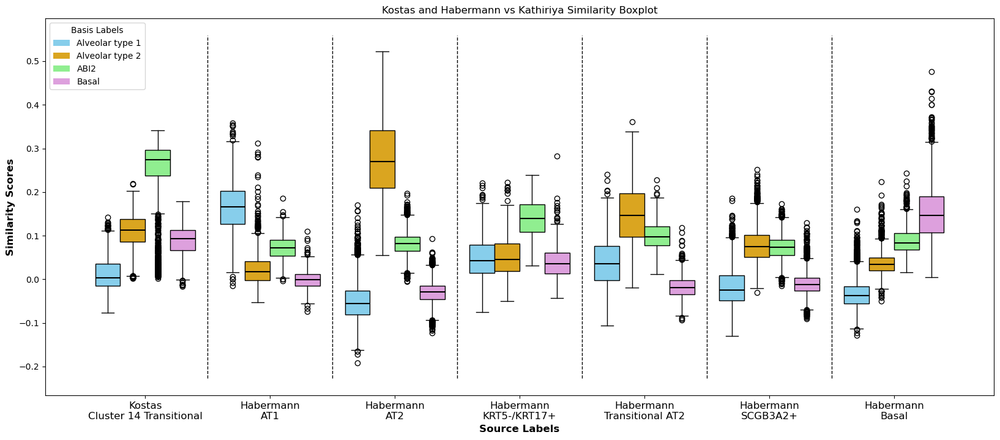

In [86]:
combinedSimilarityMap = kostasSimilarityMap
for label in kostasSimilarityMap:
    if label in habermannSimilarityMap:
        for trueLabel in habermannSimilarityMap[label]:
            combinedSimilarityMap[label][trueLabel] = habermannSimilarityMap[label][trueLabel]

basisKept = ['Alveolar type 1', 'Alveolar type 2', 'ABI2', "Basal"]
fig, ax = plt.subplots(figsize=(20, 8))
plt.title("Kostas and Habermann vs Kathiriya Similarity Boxplot")
labelIdxStartMap = {0: "Kostas", len(kostasKept): "Habermann"}
SimilarityHelper.similarityBoxplot(ax, kostasKept + habermannKept, basisKept, combinedSimilarityMap, labelIdxStartMap=labelIdxStartMap)
plt.savefig('Kostas and Habermann vs Kathiriya Similarity Boxplot (No ABI1).png')
plt.show()

In [217]:
habermannSimilarityMap.keys()

dict_keys(['Alveolar type 1', 'Alveolar type 2', 'ABI1', 'ABI2'])